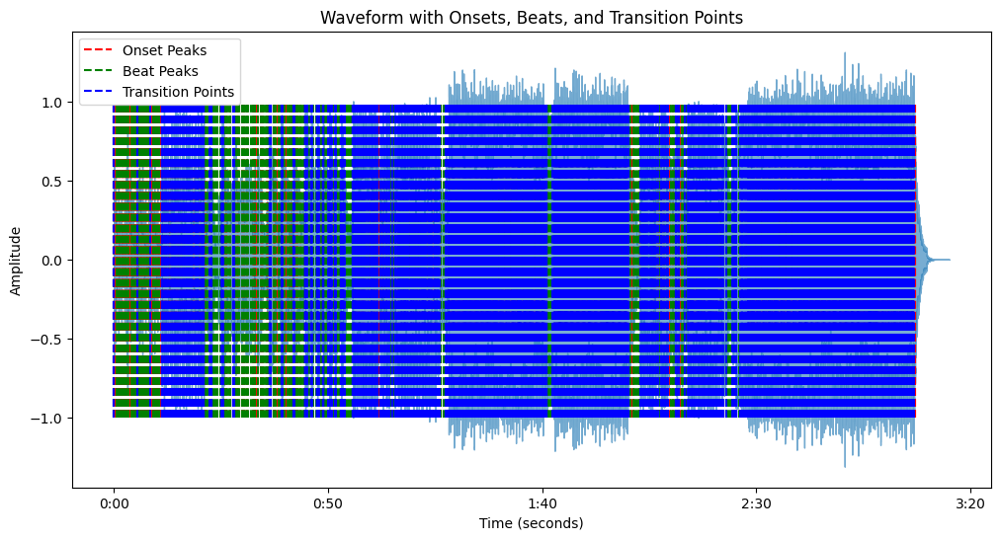

In [5]:
import librosa
import librosa.display
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio

# Load audio file
audio_path = "playlist/Andromedik & Luka - Lied To You.mp3"
y, sr = librosa.load(audio_path, sr=44100)

# Step 1: Detect Onsets (improved with additional features)
onset_env = librosa.onset.onset_strength(y=y, sr=sr)

# Detect onset frames
onset_frames = librosa.onset.onset_detect(onset_envelope=onset_env, sr=sr)
onset_times = librosa.frames_to_time(onset_frames, sr=sr)

# Step 2: Beat Detection and Tempo Estimation
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr, onset_envelope=onset_env)
beat_times = librosa.frames_to_time(beat_frames, sr=sr)

# Step 3: Compute Spectral Flux manually
# Calculate the short-time Fourier transform (STFT)
D = librosa.stft(y)

# Compute the magnitude spectrogram
magnitude = np.abs(D)

# Compute the difference between successive frames (spectral flux)
spectral_flux = np.sum(np.diff(magnitude, axis=1)**2, axis=0)
flux_times = librosa.frames_to_time(range(1, len(spectral_flux) + 1), sr=sr)

# Step 4: Combine Features
# We can use a combination of onset, beats, and flux to detect transitions
transition_times = []
for i in range(1, len(spectral_flux)):
    if spectral_flux[i] > np.mean(spectral_flux):  # Detect higher flux as transitions
        transition_times.append(flux_times[i])

# Plot results
plt.figure(figsize=(12, 6))

# Plot the waveform with onsets and beats
librosa.display.waveshow(y, sr=sr, alpha=0.6)
plt.vlines(onset_times, ymin=-1, ymax=1, color='r', linestyle='--', label="Onset Peaks")
plt.vlines(beat_times, ymin=-1, ymax=1, color='g', linestyle='--', label="Beat Peaks")
plt.vlines(transition_times, ymin=-1, ymax=1, color='b', linestyle='--', label="Transition Points")

# Title and labels
plt.title("Waveform with Onsets, Beats, and Transition Points")
plt.xlabel("Time (seconds)")
plt.ylabel("Amplitude")
plt.legend()
plt.show()

# Return audio object for playback
Audio(audio_path)


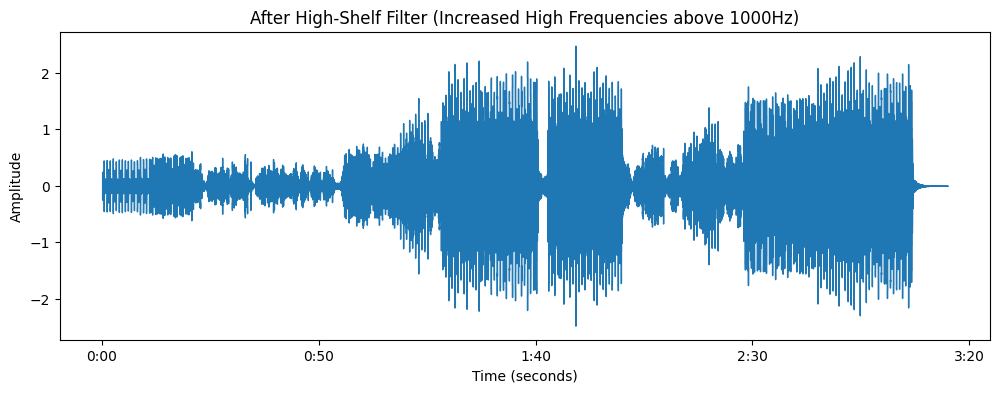

In [12]:
def butter_high_shelf(cutoff, fs, gain=1.0, order=5):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    b = b * gain  # Apply gain for boosting
    return b, a

def butter_high_shelf_filter(data, cutoff, fs, gain, order=5):
    b, a = butter_high_shelf(cutoff, fs, gain, order)
    y = lfilter(b, a, data)
    return y

def increase_high_frequencies(audio_path, cutoff=1000, gain=1.5, plot=True, play=True):
    # Load the audio file
    y, sr = librosa.load(audio_path, sr=44100)

    # Apply the high-shelf filter
    y_filtered = butter_high_shelf_filter(y, cutoff, sr, gain)

    if plot:
        # Plot the waveform
        plt.figure(figsize=(12, 4))
        librosa.display.waveshow(y_filtered, sr=sr)
        plt.title(f"After High-Shelf Filter (Increased High Frequencies above {cutoff}Hz)")
        plt.xlabel("Time (seconds)")
        plt.ylabel("Amplitude")
        plt.show()

    if play:
        # Play the filtered audio
        display(Audio(y_filtered, rate=sr))

    return y_filtered, sr

# Example usage
y_filtered, sr = increase_high_frequencies(audio_path)


In [ ]:
##increase low frequencies

def butter_low_shelf(cutoff, fs, gain=1.0, order=5):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    b = b * gain  # Apply gain for boosting
    return b, a

def butter_low_shelf_filter(data, cutoff, fs, gain, order=5):
    b, a = butter_low_shelf(cutoff, fs, gain, order)
    y = lfilter(b, a, data)
    return y

def increase_low_frequencies(audio_path, cutoff=100, gain=1.5, plot=True, play=True):
    # Load the audio file
    y, sr = librosa.load(audio_path, sr=44100)

    # Apply the low-shelf filter
    y_filtered = butter_low_shelf_filter(y, cutoff, sr, gain)

    if plot:
        # Plot the waveform
        plt.figure(figsize=(12, 4))
        librosa.display.waveshow(y_filtered, sr=sr)
        plt.title(f"After Low-Shelf Filter (Increased Low Frequencies below {cutoff}Hz)")
        plt.xlabel("Time (seconds)")
        plt.ylabel("Amplitude")
        plt.show()

    if play:
        # Play the filtered audio
        display(Audio(y_filtered, rate=sr))

    return y_filtered, sr

# Example usage
y_filtered, sr = increase_low_frequencies(audio_path)
